In [54]:
import pandas as pd 
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [55]:
# Set pandas settings to show all data when using .head(), .columns etc.
pd.options.display.max_columns = None
pd.options.display.max_rows = None

In [102]:
df = pd.read_csv('ASRS_20y_data.csv')
df['Detector']

/Users/gs/Desktop/sample_project/env/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3457: DtypeWarning: Columns (8,13,16,20,30,39,40,41,42,43,44,45,46,47,48,49,50,51,68,70,71,72,73,74,79,80,82,83,84,87,90,92,99,100,103,108,109,110,111,115,117,122,123,124) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


0                                Person Air Traffic Control
1                                Person Air Traffic Control
2                                        Person Flight Crew
3                                Person Air Traffic Control
4         Automation Aircraft Terrain Warning; Person Fl...
5                                Person Air Traffic Control
6                                        Person Flight Crew
7                                        Person Flight Crew
8         Automation Aircraft Terrain Warning; Person Fl...
9         Automation Aircraft Terrain Warning; Person Fl...
10                               Person Air Traffic Control
11                                       Person Flight Crew
12        Automation Aircraft Terrain Warning; Person Fl...
13                               Person Air Traffic Control
14                               Person Air Traffic Control
15        Automation Aircraft Terrain Warning; Person Fl...
16                               Person 

In [57]:
df['Function'].unique()

array(['Departure; Approach', 'Enroute', 'Pilot Flying; First Officer',
       'Ground', 'Single Pilot', 'Approach; Departure',
       'Pilot Not Flying; Instructor', 'Captain; Pilot Not Flying',
       'Pilot Flying', 'Pilot Not Flying; Captain',
       'First Officer; Pilot Not Flying', 'Captain; Pilot Flying',
       'Pilot Flying; Captain', 'Local',
       'Pilot Not Flying; First Officer', 'First Officer',
       'Instructor; Pilot Not Flying', 'Single Pilot; Pilot Flying',
       'Instructor; Pilot Flying', 'First Officer; Pilot Flying',
       'Ground; Supervisor / CIC', 'Captain',
       'Pilot Flying; Single Pilot', nan,
       'Pilot Not Flying; Relief Pilot', 'Pilot Not Flying',
       'Flight Service', 'Pilot Flying; Trainee', 'Captain; Instructor',
       'Pilot Not Flying; Check Pilot; Captain', 'Instructor',
       'Pilot Not Flying; Instructor; Captain', 'Other / Unknown',
       'Pilot Flying; Instructor', 'Traffic Management',
       'Check Pilot; Instructor', 'Superv

# Detector

## Split each entry when it meets the character '; ' and stack it.

In [58]:
df['Detector'] = df['Detector'].str.split('; ', expand =True).stack().reset_index(
    drop=True)

In [59]:
(df['Detector'] =='Automation Collision Avoidance System (UAS)').sum()

1

## Drop the entries where you'd find 'UAS' mentionned

In [60]:
for i, row in enumerate(df['Detector']):
    if 'UAS' in row:
        df['Detector'] = df['Detector'].drop(i)

In [61]:
(df['Detector'] =='Automation Collision Avoidance System (UAS)').sum()

0

In [62]:
(df['Detector'] =='Person Visual Observer (UAS)').sum()

0

In [63]:
df_detector = df['Detector'].dropna() 
# I created a new variable df_detector because I couldn't overwrite df['Detector']

In [64]:
df_detector.isnull().sum()

0

## Create a dictionary with the different macrofeature

In [65]:
detector = {'Automation' :[],
            'Person' : [],
            'else' : []} # I add other to see if I have some 
                          # other values than 'Automation' and
                          # 'Person' in my Serrie

In [66]:
for title in df_detector:
    if 'Automation' in title:
        detector['Automation'].append(title)
    elif 'Person' in title:
        detector['Person'].append(title)
    else:
        detector['else'].append(title)

## Plot a histogram with each feature in the macrofeature 'Automation'

/Users/gs/Desktop/sample_project/env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

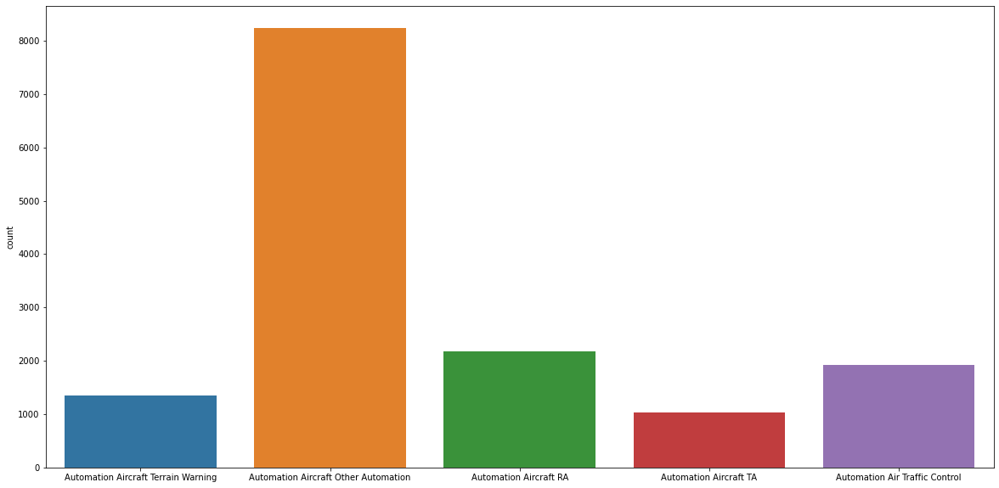

In [67]:
plt.figure(figsize = (20,10))
sns.countplot(detector['Automation'])

## plot a histogram with each feature in the macrofeature 'Person'

/Users/gs/Desktop/sample_project/env/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:ylabel='count'>

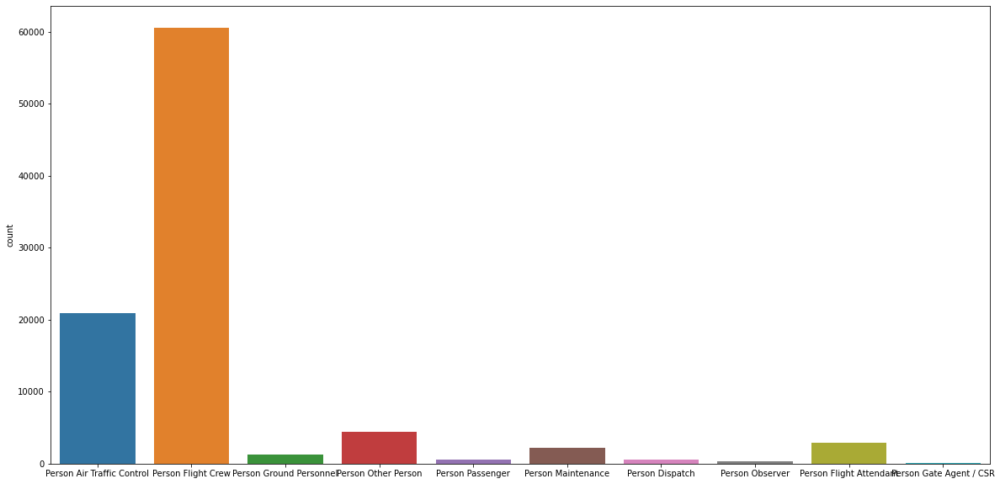

In [68]:
plt.figure(figsize = (20,10))
sns.countplot(detector['Person'])

# Function

## Split each entry when it meets the character '; ' and stack it.

In [69]:
df['Function'] = df['Function'].str.split('; ', expand =True).stack().reset_index(
    drop=True)

## Drop the entries where you'd find 'UAS' mentionned

In [70]:
for i, row in enumerate(df['Function']):
    if 'UAS' in row:
        df['Function'] = df['Function'].drop(i)

In [71]:
df['Function'].isna().sum()

118

In [72]:
#Drop the null values in the df['Function'] by creating a new variable
# df_function
df_function = df['Function'].dropna() 

In [73]:
df_function.isna().sum()

0

In [74]:
df['Function'].unique()

array(['Departure', 'Approach', 'Enroute', 'Pilot Flying',
       'First Officer', 'Ground', 'Single Pilot', 'Pilot Not Flying',
       'Instructor', 'Captain', 'Local', 'Supervisor / CIC',
       'Relief Pilot', 'Flight Service', 'Trainee', 'Check Pilot',
       'Other / Unknown', 'Traffic Management', 'Handoff / Assist',
       'Flight Data / Clearance Delivery', 'Observer', 'Ramp',
       'FBO Personnel', 'Dispatcher', 'Flight Attendant (On Duty)',
       'Oceanic', 'Flight Attendant In Charge', 'Technician',
       'Flight Engineer / Second Officer', nan, 'Coordinator',
       'Gate Agent / CSR', 'Vehicle Driver', 'Lead Technician',
       'Passenger', 'Safety Pilot', 'skydiver', 'Unicom Operations',
       'Off Duty', 'Airport Personnel', 'Safety Manager',
       'Safety Analyst', 'SAFETY MANAGER', 'DPE', 'SMS Analyst',
       'Safety Ananlyst', 'Operations Manager', 'Safety Officer',
       'Parts / Stores Personnel', 'Flight Safety Officer',
       'Drone Operator', 'Jet bridge 

## replace the spaces between a forward slash (' / ') to meat the same writing as you'd find in the PDF file

In [75]:
df_function = df_function.apply(lambda x:x.replace(' / ', '/'))
df_function

0                              Departure
1                               Approach
2                                Enroute
3                           Pilot Flying
4                          First Officer
5                                 Ground
6                           Single Pilot
7                               Approach
8                              Departure
9                           Single Pilot
10                      Pilot Not Flying
11                            Instructor
12                               Captain
13                      Pilot Not Flying
14                               Captain
15                      Pilot Not Flying
16                             Departure
17                              Approach
18                          Pilot Flying
19                      Pilot Not Flying
20                               Captain
21                               Enroute
22                          Single Pilot
23                         First Officer
24              

Creating a dictionary with an emty list of the different macrofeatures

In [76]:
function = {'Flight Crew' :[],
            'Air Traffic Control' : [],
            'Maintenance' :[],
            'Flight Attendant' :[],
            'Dispatch': [],
            'Ground Personnel':[],
            'other' : [],
            'trainee':[],
            'else': []} # I add other to see if I have some 
                          # other values than 'Automation' and
                          # 'Person' in my Serrie

In the df['Function'] case, we do not have the name of the macrofeature that precede the name of each feature in the table. Consequently, I needed to creat lists in the different microfeatures that I can find in each macrofeature in the PDF file. 

In [77]:
flight_crew_unique = ['Captain', 'Check Pilot','First Officer',
                     'Flight Engineer/Second Officer','Instructor',
                     'Pilot Flying','Pilot Not Flying','Relief Pilot',
                     'Single Pilot']

In [78]:
air_traffic_control_unique = ['Approach','Coordinator','Departure',
                             'Enroute','Flight Data/Clearance Delivery',
                             'Flight Service','Ground','Handoff/Assist',
                             'Instructor','Trainee','Local','Oceanic',
                             'Supervisor/CIC', 'Traffic Management']

In [79]:
maintenance_unique = ['Inspector', 'Instructor','Lead Technician',
              'Parts/Stores Personnel','Quality Assurance/Audit',
              'Technician'] #you don't know which 
                            #trainee we talk about

In [80]:
flight_attendant_unique =['Flight Attendant In Charge',
                          'Flight Attendant (On Duty)',
                          'Off Duty']

In [81]:
dispatch_unique =['Dispatcher']

In [82]:
ground_personnel_unique = ['Airport Personnel','FBO Personnel',
                   'Gate Agent/CSR','Ramp', 'Vehicle Driver']

In [83]:
other_unique = ['Observer', 'Passenger', 'Other', 'Other/Unknown']

Looping through each lists of unique values and add the corresponding string to the right list of macrofeatures in the dictionary

In [84]:
for title in df_function:
    if title in air_traffic_control_unique:
        function['Air Traffic Control'].append(title)
    elif title in flight_crew_unique:
        function['Flight Crew'].append(title)
    elif title in maintenance_unique:
        function['Maintenance'].append(title)
    elif title in flight_attendant_unique:
        function['Flight Attendant'].append(title)
    elif title in dispatch_unique:
        function['Dispatch'].append(title)
    elif title in ground_personnel_unique:
        function['Ground Personnel'].append(title)
    elif title in other_unique:
        function['other'].append(title)
    elif title in trainee_unique:
        function['trainee'].append(title)
    else:
        function['else'].append(title)

NameError: name 'trainee_unique' is not defined

In [85]:
function['else']

[]

In [86]:
len(function['else'])

0

## Plot a histogram with each feature in the macrofeature 'Automation'

In [ ]:
for key in function.keys():
    plt.figure(figsize = (40,10))
    if len(function[key])!=0:
        plt.title(key)
        sns.countplot(function[key])

# Qualification

## Split each entry when it meets the character '; ' and stack it.

In [90]:
df['Qualification'].unique()

numpy.ndarray

In [99]:
# Write all the unique entries into a single string variable, using your favorite separator,
# here we use ' $ '
my_string = ' $ '.join(str(entry) for entry in df['Qualification'].unique())

In [101]:
# Read the string as long as you want using string slicing
my_string[:100000]

'Air Traffic Control Developmental $ Air Traffic Control Fully Certified $ nan $ Flight Crew Private $ Flight Crew Commercial; Flight Crew Instrument; Flight Crew Multiengine $ Flight Crew Multiengine; Flight Crew Instrument; Flight Crew Flight Instructor; Flight Crew Commercial $ Flight Crew Air Transport Pilot (ATP) $ Flight Crew Air Transport Pilot (ATP); Flight Crew Flight Instructor; Flight Crew Multiengine $ Flight Crew Student $ Flight Crew Air Transport Pilot (ATP); Flight Crew Flight Instructor; Flight Crew Instrument; Flight Crew Multiengine $ Flight Crew Instrument; Flight Crew Multiengine; Flight Crew Air Transport Pilot (ATP); Flight Crew Flight Instructor $ Flight Crew Commercial $ Flight Crew Air Transport Pilot (ATP); Flight Crew Multiengine; Flight Crew Instrument $ Flight Crew Private; Flight Crew Multiengine; Flight Crew Instrument $ Flight Crew Commercial; Flight Crew Flight Instructor $ Flight Crew Private; Flight Crew Instrument $ Flight Crew Air Transport Pilot (

In [87]:
df['Qualification'].isna().sum()

19492

In [354]:
df['Qualification'] = df['Qualification'].str.split('; ', expand=True).stack().reset_index(
drop=True)

In [355]:
df['Qualification'].isna().sum()

0

In [356]:
df['Qualification']

0               Air Traffic Control Developmental
1             Air Traffic Control Fully Certified
2             Air Traffic Control Fully Certified
3                             Flight Crew Private
4             Air Traffic Control Fully Certified
5                          Flight Crew Commercial
6                          Flight Crew Instrument
7                         Flight Crew Multiengine
8                         Flight Crew Multiengine
9                          Flight Crew Instrument
10                  Flight Crew Flight Instructor
11                         Flight Crew Commercial
12          Flight Crew Air Transport Pilot (ATP)
13          Flight Crew Air Transport Pilot (ATP)
14            Air Traffic Control Fully Certified
15          Flight Crew Air Transport Pilot (ATP)
16            Air Traffic Control Fully Certified
17                            Flight Crew Private
18            Air Traffic Control Fully Certified
19          Flight Crew Air Transport Pilot (ATP)


## Drop the entries where you'd find 'UAS' mentionned

In [357]:
df['Qualification'].shape

(91637,)

In [358]:
for i, entry in enumerate(df['Qualification']):
    if 'UAS' in entry:
        df['Qualification']=df['Qualification'].drop(i)

In [359]:
df['Qualification'].shape

(91637,)

In [360]:
df_qualification = df['Qualification'].dropna()

In [361]:
df_qualification

0               Air Traffic Control Developmental
1             Air Traffic Control Fully Certified
2             Air Traffic Control Fully Certified
3                             Flight Crew Private
4             Air Traffic Control Fully Certified
5                          Flight Crew Commercial
6                          Flight Crew Instrument
7                         Flight Crew Multiengine
8                         Flight Crew Multiengine
9                          Flight Crew Instrument
10                  Flight Crew Flight Instructor
11                         Flight Crew Commercial
12          Flight Crew Air Transport Pilot (ATP)
13          Flight Crew Air Transport Pilot (ATP)
14            Air Traffic Control Fully Certified
15          Flight Crew Air Transport Pilot (ATP)
16            Air Traffic Control Fully Certified
17                            Flight Crew Private
18            Air Traffic Control Fully Certified
19          Flight Crew Air Transport Pilot (ATP)


# Create a dictionary with the different macrofeature

In [362]:
qualification = {'Flight Crew' : [],
                 'Air Traffic Control': [],
                 'Maintenance': [],
                 'Flight Attendant': [],
                 'Dispatch':[],
                 'Other':[],
                 'else': []}

In [363]:
for entry in df_qualification:
    if 'Flight Crew' in entry:
        qualification['Flight Crew'].append(entry)
    elif 'Air Traffic Control' in entry:
        qualification['Air Traffic Control'].append(entry)
    elif 'Maintenance' in entry:
        qualification['Maintenance'].append(entry)
    elif 'Flight Attendant' in entry:
        qualification['Flight Attendant'].append(entry)
    elif 'Dispatch' in entry:
        qualification['Dispatch'].append(entry)
    elif 'Other' in entry:
        qualification['Other'].append(entry)
    else:
        qualification['else'].append(entry) # interesting way to know
                                            # if you have additional
                                            # features that are not
                                            # mentionned in the PDF

## Plot a histogram with each feature in the macrofeature 'Qualification'

/Users/hicheme/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/hicheme/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/hicheme/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warn

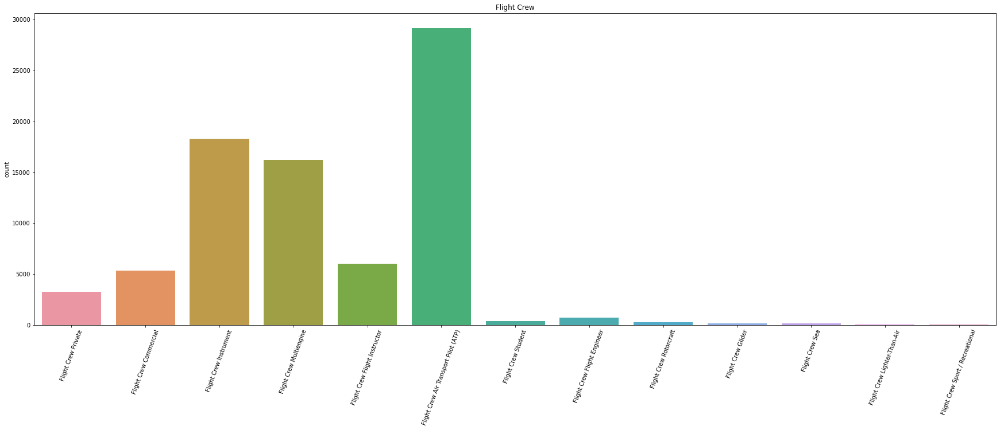

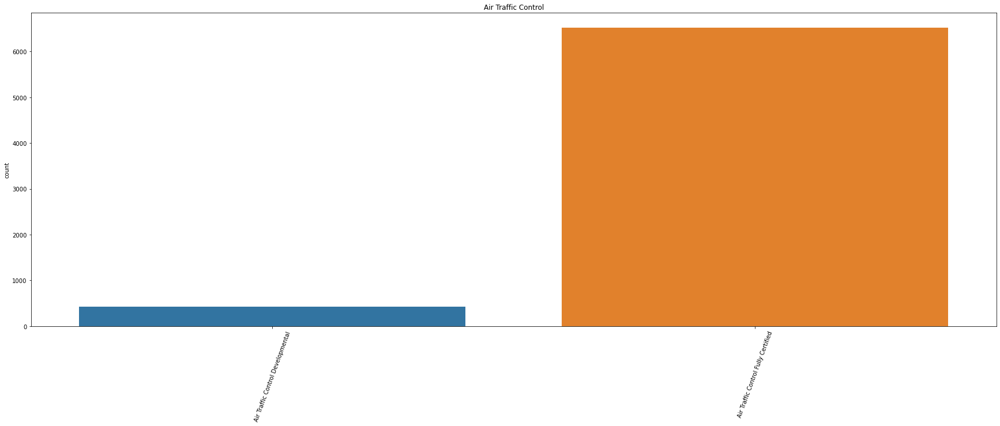

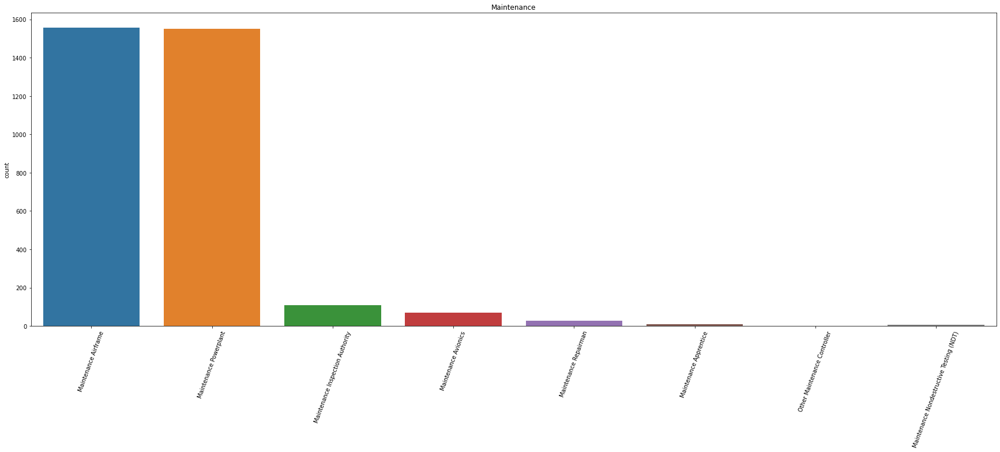

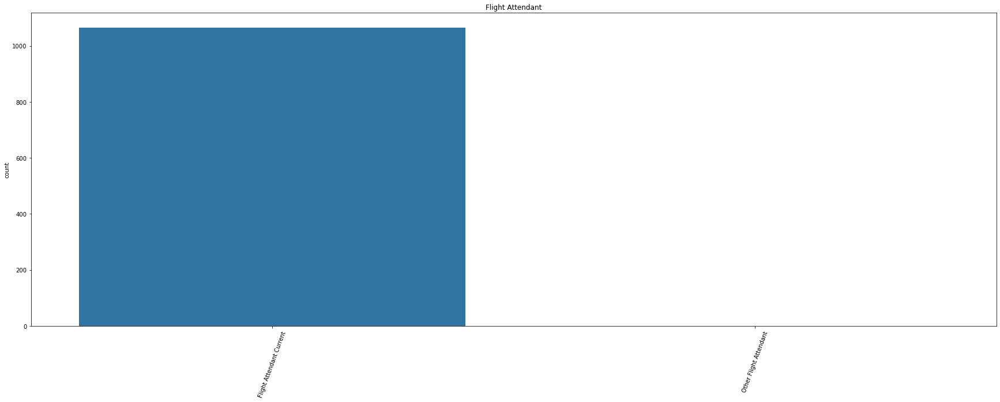

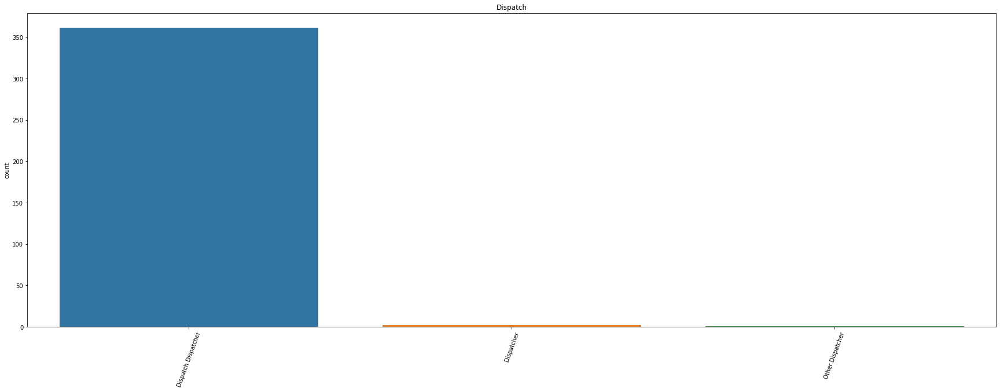

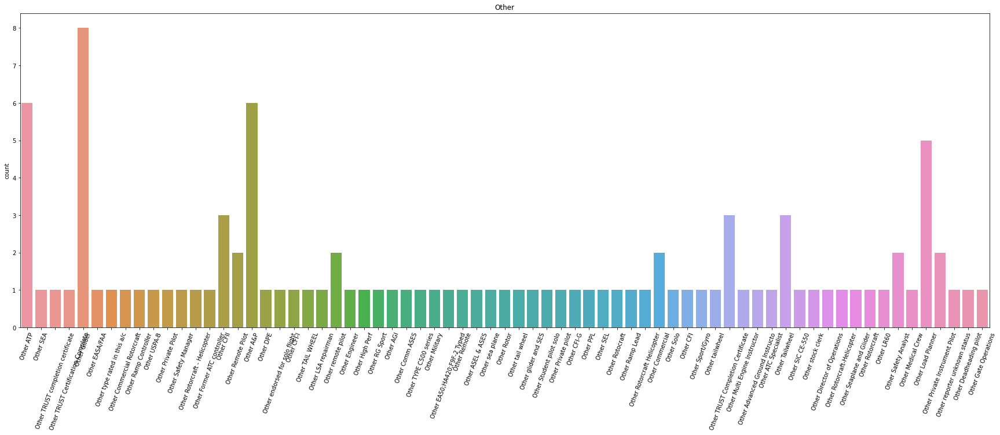

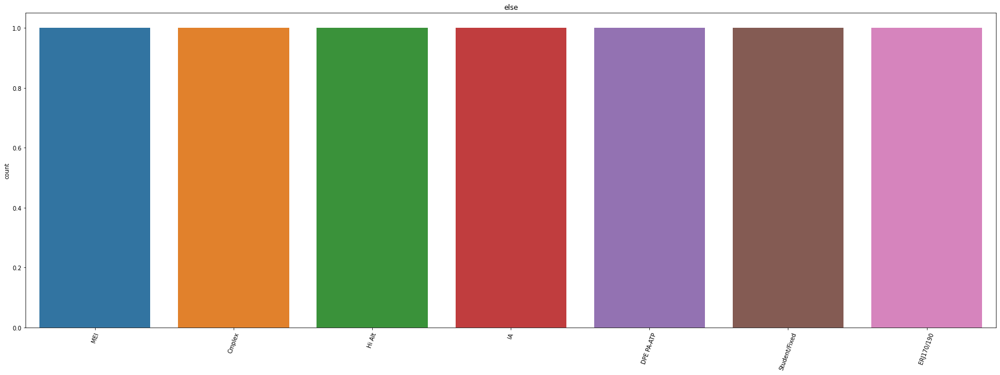

In [364]:
for key in qualification:
    plt.figure(figsize =(30,10))
    plt.xticks(rotation =70)
    plt.title(key)
    sns.countplot(qualification[key])

# Experience

## Split each entry when it meets the character '; ' and stack it.

In [106]:
# Write all the unique entries into a single string variable, using your favorite separator,
# here we use ' $ '
my_string = " $\n ".join(str(entry) for entry in df['Experience'].unique())

# Read the string as long as you want using string slicing
my_string[:100000]

'nan $\n Flight Crew Last 90 Days 156; Flight Crew Type 290 $\n Flight Crew Last 90 Days 7; Flight Crew Total 314; Flight Crew Type 140 $\n Flight Crew Last 90 Days 45; Flight Crew Total 4500; Flight Crew Type 1100 $\n Flight Crew Last 90 Days 300; Flight Crew Total 5500; Flight Crew Type 4000 $\n Flight Crew Last 90 Days 210; Flight Crew Total 17550; Flight Crew Type 10250 $\n Flight Crew Last 90 Days 178; Flight Crew Type 12000 $\n Flight Crew Last 90 Days 25; Flight Crew Total 220; Flight Crew Type 160 $\n Flight Crew Last 90 Days 185 $\n Flight Crew Last 90 Days 75; Flight Crew Total 3850; Flight Crew Type 675 $\n Flight Crew Last 90 Days 75; Flight Crew Total 12500; Flight Crew Type 1425 $\n Flight Crew Last 90 Days 5; Flight Crew Total 65; Flight Crew Type 63 $\n Flight Crew Last 90 Days 61; Flight Crew Total 7000; Flight Crew Type 300 $\n Flight Crew Last 90 Days 100; Flight Crew Total 8900; Flight Crew Type 1800 $\n Flight Crew Last 90 Days 29; Flight Crew Total 8090; Flight Cr

In [365]:
df['Experience'] = df['Experience'].str.split(
    '; ', expand=True).stack().reset_index(drop =True)

## Drop where you'd find a mention of UAS

In [366]:
for i, entry in enumerate(df['Experience']):
    if 'UAS' in entry:
        df['Experience'] = df['Experience'].drop(i)

In [367]:
df_experience = df['Experience'].dropna()

In [368]:
df_experience.isna().sum()

0

## Create a dictionary with the different macrofeature

In [369]:
experience  =  {'Flight Crew' : [],
                 'Air Traffic Control': [],
                 'Maintenance': [],
                 'Flight Attendant': [],
                 'Dispatch':[],
                 'else': []}

In [370]:
for entry in df_experience:
    if 'Flight Crew' in entry:
        experience['Flight Crew'].append(entry)
    elif 'Air Traffic Control' in entry:
        experience['Air Traffic Control'].append(entry)
    elif 'Maintenance' in entry:
        experience['Maintenance'].append(entry)
    elif 'Flight Attendant' in entry:
        experience['Flight Attendant'].append(entry)
    elif 'Dispatch' in entry:
        experience['Dispatch'].append(entry)
    else:
        experience['else'].append(entry) # interesting way to know
                                            # if you have additional
                                            # features that are not
                                            # mentionned in the PDF

## ## Plot a histogram with each feature in the macrofeature 'Experience'

/Users/hicheme/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/hicheme/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/hicheme/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warn

ValueError: min() arg is an empty sequence

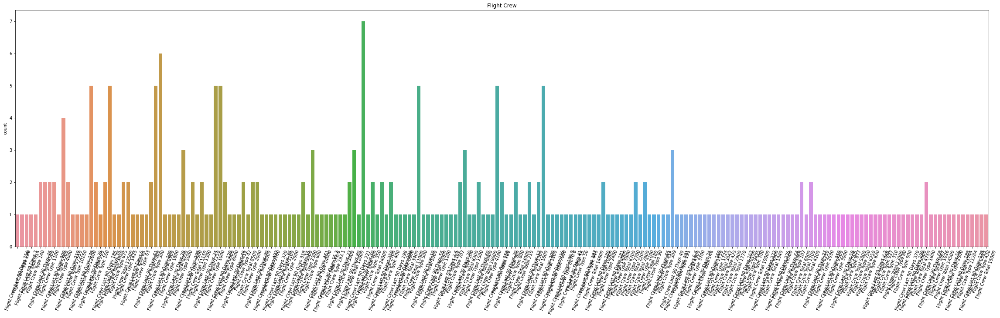

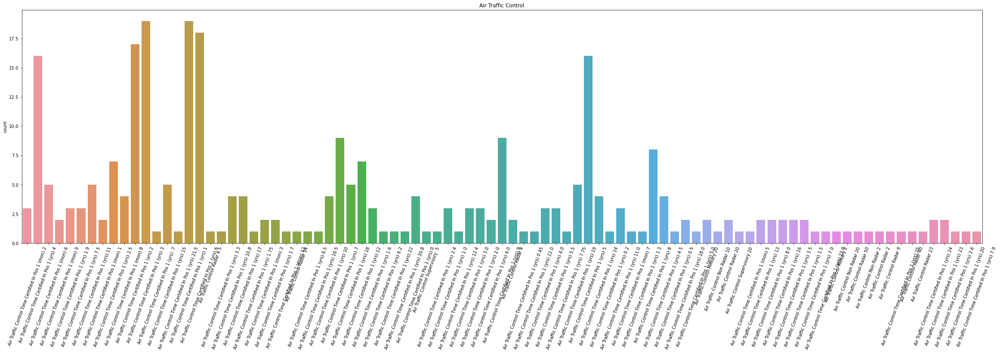

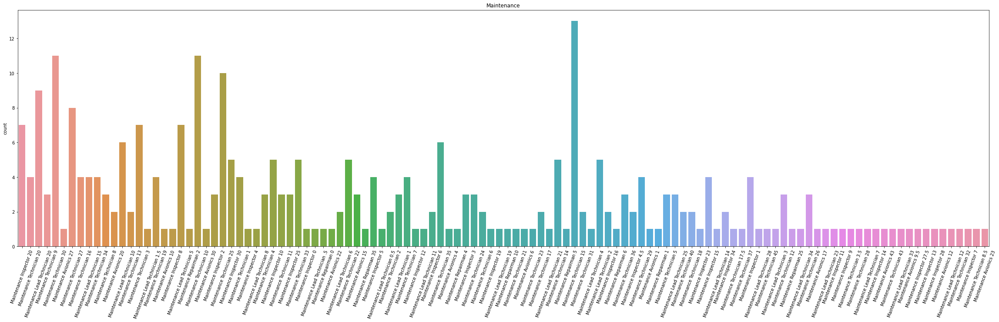

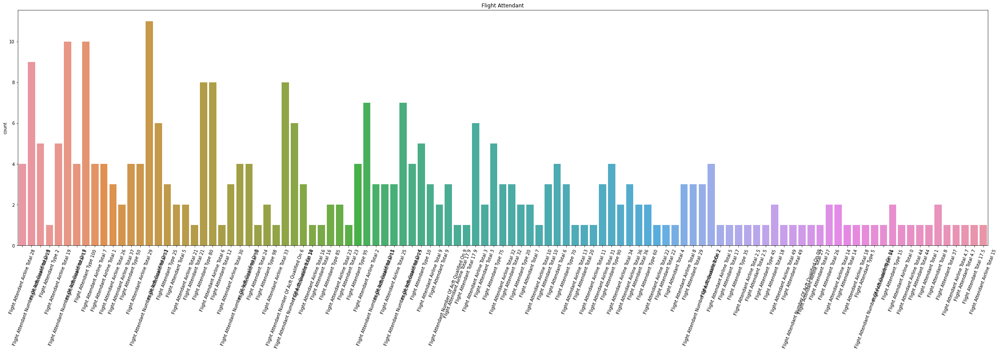

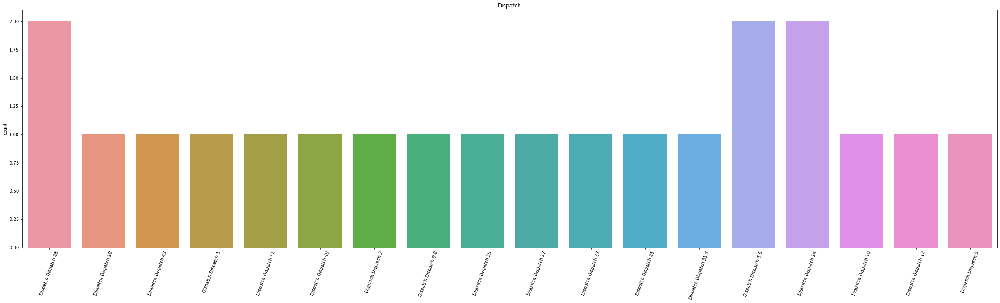

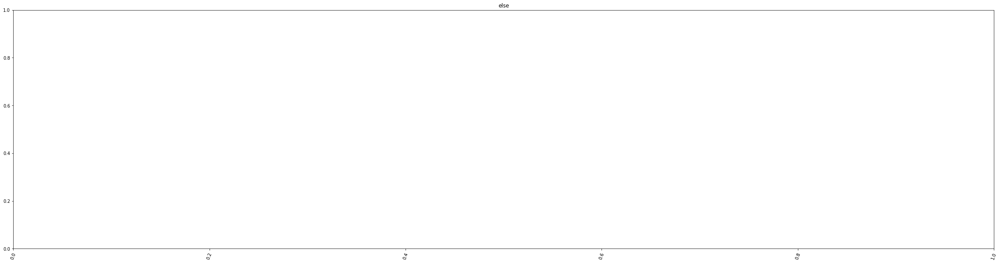

In [389]:
for key, value in experience.items():
    plt.figure(figsize =(40,10))
    plt.title(key)
    plt.xticks(rotation = 70)
    if len(value)<400:
        sns.countplot(experience[key])
    else:
        sns.countplot(experience[key][:300])